In [185]:
import h5py
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import butter, filtfilt
import glob
import os
import time  # Import the time module
from datetime import datetime
import gc  # Garbage collector

In [186]:
def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs  # Nyquist frequency
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    y = filtfilt(b, a, data, axis=1)  # Assuming time is along the x-axis (axis=1)
    return y

In [187]:
# Flag to control bandpass filter application
apply_bandpass_filter = False  # Set to False to deactivate the filter

In [188]:
pulsefreq=40000 # Hz 
samplespacing=0.4 #meters
first_distance = 100 #meters to first measure point in acquisition profile

# Set your parameters
delta_t = 1/pulsefreq  # Spacing between elements in seconds
f_low = 10  # Low cutoff frequency in Hz
f_high = 1000  # High cutoff frequency in Hz

In [189]:
def downsample_data(data, factor):
    # Downsample data by taking every 'factor'th element along the x-axis
    return data[:, ::factor]

In [190]:
def moving_average_2d(data, window_size):
    # Flatten the data
    flattened_data = data.flatten()
    
    # Apply the moving average filter
    smoothed_flattened_data = np.convolve(flattened_data, np.ones(window_size)/window_size, mode='same')
    
    # Reshape the data back to its original shape
    smoothed_data = smoothed_flattened_data.reshape(data.shape)
    
    return smoothed_data

In [191]:
# Set your downsampling factor in time
downsample_factor = 1  # Replace with your desired factor

In [192]:
# Replace 'your_file.hdf5' with the path to your HDF5 file
hdf5_dir = r'E:/be22004_018'

# Directory to save images
#image_dir = r'E:\thesis2024\fft_testing'
image_dir = r'E:/thesis2024/ImageData/oilandgas/be22004_018'

In [193]:
def parse_date_from_filename(filename):
    # Extract the date and time part from the filename
    date_str = os.path.splitext(os.path.basename(filename))[0]
    # Assuming format is like 'DD.MM.YYYY_HH.MM.SS_00', adjust as needed
    date_str = date_str.rsplit('_', 1)[0]  # Remove the '_00' suffix
    return datetime.strptime(date_str, '%d.%m.%Y_%H.%M.%S')


In [194]:
hdf5_files = glob.glob(os.path.join(hdf5_dir, '*.hdf5'))
# Sort files based on the date and time in their names
hdf5_files.sort(key=parse_date_from_filename)
print(len(hdf5_files),'Files,',  'Total time = ', len(hdf5_files)*10, 'secs')
print(*hdf5_files,  sep='\n')

7 Files, Total time =  70 secs
E:/be22004_018\16.02.2022_13.48.55_00.hdf5
E:/be22004_018\16.02.2022_13.49.05_00.hdf5
E:/be22004_018\16.02.2022_13.49.15_00.hdf5
E:/be22004_018\16.02.2022_13.49.25_00.hdf5
E:/be22004_018\16.02.2022_13.49.35_00.hdf5
E:/be22004_018\16.02.2022_13.49.45_00.hdf5
E:/be22004_018\16.02.2022_13.49.55_00.hdf5


In [195]:
from scipy.signal.windows import boxcar, gaussian
from scipy.signal import ShortTimeFFT

In [196]:
# create a time-window
#N_wnd = pulsefreq  # window length
##N_wnd = 32768
##N_wnd = 2048
##N_wnd = 4896
N_wnd = 16384
wnd = boxcar(N_wnd) # make window

N_hop = N_wnd // 2  # window hopping samples

SFT = ShortTimeFFT(wnd, hop=N_hop, fs=pulsefreq, mfft=N_wnd, scale_to='magnitude')  # creat the STFT object

In [197]:
def getSTFT4DataAtLoci(dat, loci, SFT, padData=False):
    
    N_wnd = len(SFT.win)  # Get the window length from the SFT object
    
    if padData:
        # If we do data padding (unused now !!)
        dat_ext = padData(dat, np.zeros((dat.shape[0], N_wnd//2)), [])  # Pad the data in the front to use the beginning segment of the data
    else:
        # No data padding
        dat_ext = dat.copy()
    
    # Do the STFT
    S_dat = SFT.stft(dat_ext[loci,:], axis=1)  
    
    # Get the magnitude of the transformed data    
    mag_S_dat = abs(S_dat)  # 3-d array: (loci, freq index, time window index)
    
    # Get the the boundary indices of the moving window
    p1 = SFT.lower_border_end[1]
    p2 = SFT.upper_border_begin(dat_ext.shape[1])[1]
    
    # Get the times at the centers of the moving windows
    t_windowCenters = np.arange(p1,p2) * SFT.delta_t
    
    return mag_S_dat[:,:,p1:p2], (p1, p2), t_windowCenters 

In [198]:
loci = np.arange(0,40)

Data loaded from file: E:/be22003_028\15.02.2022_15.23.00_00.hdf5
(675, 401407)
Downsampled filtered data shape: (675, 401407)
Sliced data shape: (40, 401407)


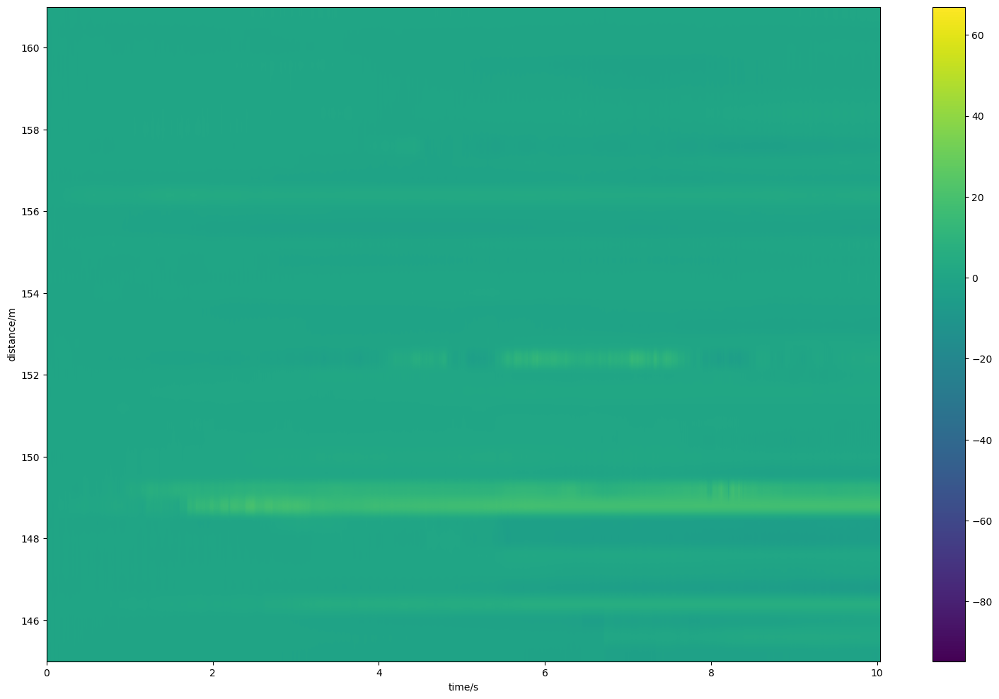

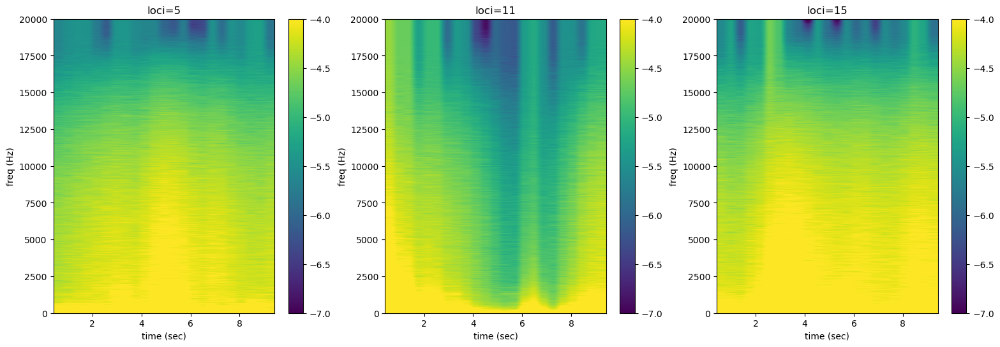

In [41]:
data_dict = {}  # Initialize data dictionary to store data for each file

# for file_path in hdf5_files:
for file_path in hdf5_files[0:1]:
    #print(f"Processing file: {file_path}")
    with h5py.File(file_path, 'r') as file:
        
        group = file['Phase data group']
        data = file['Phase data group/Data'][...]  # This loads the data into memory 
        
        print(f"Data loaded from file: {file_path}")  

        # Scale factors for x and y axes
        print(data.shape)
        x_scale = (1/pulsefreq) # Replace with your x scale factor
        y_scale = samplespacing  # Replace with your y scale factor

        # Check if bandpass filter should be applied
        if apply_bandpass_filter:
            # Apply bandpass filter
            fs = 1.0 / delta_t  # Sampling frequency
            filtered_data = butter_bandpass_filter(data, f_low, f_high, fs)
        else:
            # If filter is not applied, use the original data
            filtered_data = data

        data_dict[str(parse_date_from_filename(file_path))] = [filtered_data] 
        
        # Renormalize the color scale
        vmin, vmax = np.min(filtered_data), np.max(filtered_data)      
        
        # Downsample the data
        downsampledfiltered_data = downsample_data(filtered_data, downsample_factor)
        print("Downsampled filtered data shape:", downsampledfiltered_data.shape)

        # Adjust the x-coordinates
        y_coords, x_coords = np.mgrid[0:data.shape[0], 0:data.shape[1]:downsample_factor]
        x_scaledcoords = x_coords * x_scale
        y_scaledcoords = y_coords * y_scale + first_distance

        # Define the y-axis limits
        y_lower_limit = 145  # Lower limit in meters
        y_upper_limit = 161  # Upper limit in meters

        # Find the indices corresponding to the specified y-axis limits
        y_lower_index = int((y_lower_limit - first_distance) / samplespacing)
        y_upper_index = int((y_upper_limit - first_distance) / samplespacing)

        # Slice the data to focus on the specified y-axis limits
        sliced_data = downsampledfiltered_data[y_lower_index:y_upper_index, :]
        print("Sliced data shape:", sliced_data.shape)
        

        # Apply the moving average filter with a large window size
        smoothed_data = moving_average_2d(sliced_data, window_size=2048)
        
        # Do the short-time Fourier transform
        mag_S_dat, (p1, p2), t_windowCenters = getSTFT4DataAtLoci(smoothed_data, loci, SFT)
        

        mag_S_dat.shape  # (loci index, frequency index, time window index)

        
        #Plotting the data using imshow
        plt.figure(figsize=(19, 12))
        plt.imshow(sliced_data, cmap='viridis', vmin=vmin, vmax=vmax, aspect='auto', extent=[x_scaledcoords[0, 0], x_scaledcoords[-1, -1], y_lower_limit, y_upper_limit])
        plt.colorbar()  
        plt.xlabel('time/s')  
        plt.ylabel('distance/m')


        
        fig, axes = plt.subplots(1,3,figsize=(19,6))

        idx_loc = 5  # pick a loc
        plt.axes(axes[0])
        plt.imshow(np.log10(mag_S_dat[idx_loc]), cmap='viridis', origin='lower',
                   vmin = -7, vmax = -4,   # Change these limits here to have better view if you wish
                   #vmin = -20, vmax = 20,   # Change these limits here to have better view if you wish
                   aspect = 'auto', 
                   extent = [t_windowCenters[0], t_windowCenters[-1], SFT.f[0], SFT.f[-1]]   # SFT.f gives the array of frequencies in the short-time Fourier transform
                   )
        plt.colorbar()  
        # Labeling the axes
        plt.xlabel('time (sec)')  
        plt.ylabel('freq (Hz)')  
        plt.title(f'loci={loci[idx_loc]}')
        
        idx_loc = 11  # pick a loc
        plt.axes(axes[1])
        plt.imshow(np.log10(mag_S_dat[idx_loc]), cmap='viridis', origin='lower',
                   vmin = -7, vmax = -4,   # Change these limits here to have better view if you wish
                   aspect = 'auto', 
                   extent = [t_windowCenters[0], t_windowCenters[-1], SFT.f[0], SFT.f[-1]]
                   )
        plt.colorbar()  
        # Labeling the axes
        plt.xlabel('time (sec)')  
        plt.ylabel('freq (Hz)')  
        plt.title(f'loci={loci[idx_loc]}')
        
        idx_loc = 15  # pick a loc
        plt.axes(axes[2])
        plt.imshow(np.log10(mag_S_dat[idx_loc]), cmap='viridis', origin='lower',
                   # Renormalize the color scale
                   vmin = -7, vmax = -4,
                   aspect = 'auto', 
                   extent = [t_windowCenters[0], t_windowCenters[-1], SFT.f[0], SFT.f[-1]]
                   )
        plt.colorbar()  
        # Labeling the axes
        plt.xlabel('time (sec)')  
        plt.ylabel('freq (Hz)')  
        plt.title(f'loci={loci[idx_loc]}')
        
        # Save the plot as an image
        ##filename = "spectrogram_plot"  # You can change the filename as per your requirement
        ##image_dir = r'E:/thesis2024/fft_testing'  # Specify the directory where you want to save the image
        ##image_path = os.path.join(image_dir, f"{filename}.png")  # Full path including filename and extension
        ##plt.savefig(image_path, dpi=300, bbox_inches='tight')  # Save with high resolution and tight bounding box
        ##plt.draw()  # Ensure the figure is drawn
        ##print(image_path)
        ##time.sleep(1)  # Add a short delay before saving
        #plt.close()  # Close the figure to free up memory
        plt.show()
        
        ##print(f"Saved file: {image_path}")

        

        # Save the plot as an image
        # Extracting the filename without extension and directory
        ##filename = os.path.splitext(os.path.basename(file_path).replace('.','_'))[0]
        ##image_path = os.path.join(image_dir, filename + '.png')
        #print(filename)
        #print(image_path)
        plt.tight_layout()  # Adjust layout
        
        ##plt.draw()  # Ensure the figure is drawn
        ##print(image_path)
        ##time.sleep(1)  # Add a short delay before saving
        ##plt.savefig(image_path, dpi=300, bbox_inches='tight')  # Save with high resolution and tight bounding box  # Specify DPI for higher resolution
        ##plt.show()
        ##print(f"Savedfile: {filename}")


        del data  # Free memory from the original data
        #del downsampledfiltered_data
        # del x
        # del y
        del x_scaledcoords
        del y_scaledcoords
        gc.collect()  # Explicit garbage collection
        ##print("Uncollectable garbage:", gc.garbage)
        plt.clf() 
        plt.close()  # Close the figure to free memory

       

Data loaded from file: E:/be22004_018\16.02.2022_13.48.55_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)


C:\Users\s_power\AppData\Local\Temp\ipykernel_9132\2888804363.py:93: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(wspace=0.1, hspace=0.1)


E:/thesis2024/ImageData/oilandgas/be22004_018\16_02_2022_13_48_55_00_hdf5.png


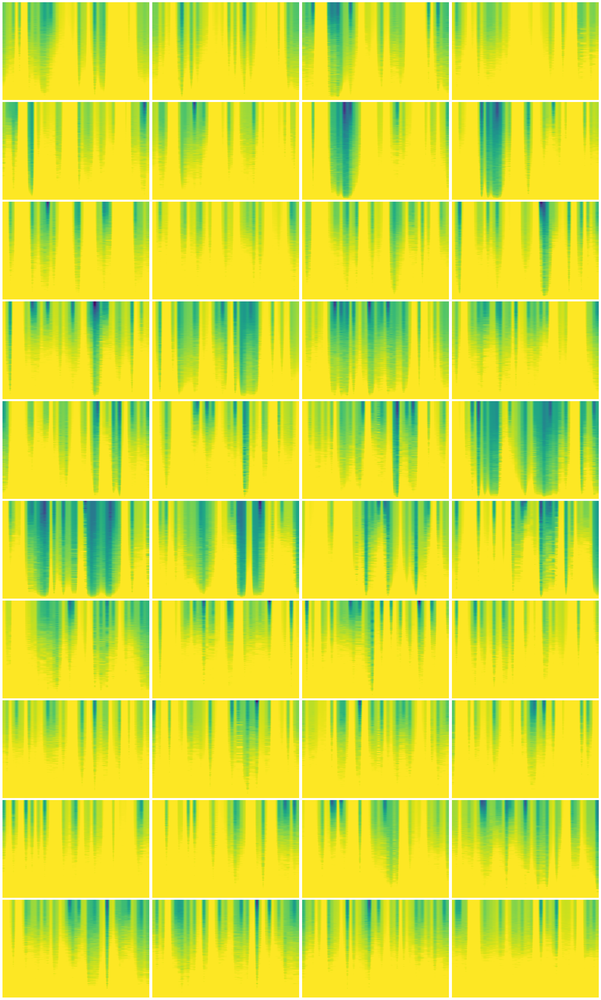

Savedfile: 16_02_2022_13_48_55_00_hdf5
Uncollectable garbage: []
Data loaded from file: E:/be22004_018\16.02.2022_13.49.05_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)
E:/thesis2024/ImageData/oilandgas/be22004_018\16_02_2022_13_49_05_00_hdf5.png


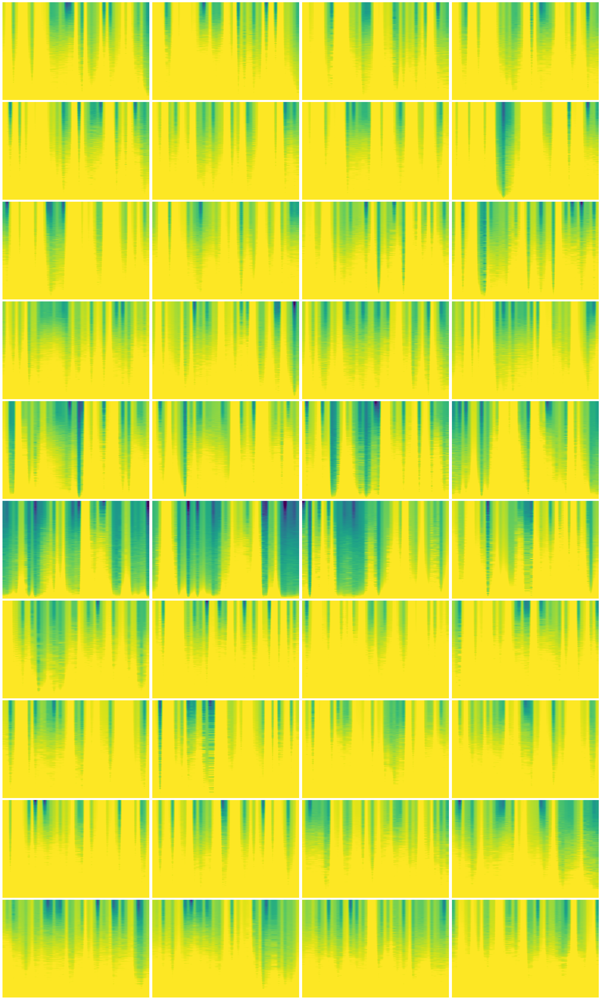

Savedfile: 16_02_2022_13_49_05_00_hdf5
Uncollectable garbage: []
Data loaded from file: E:/be22004_018\16.02.2022_13.49.15_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)
E:/thesis2024/ImageData/oilandgas/be22004_018\16_02_2022_13_49_15_00_hdf5.png


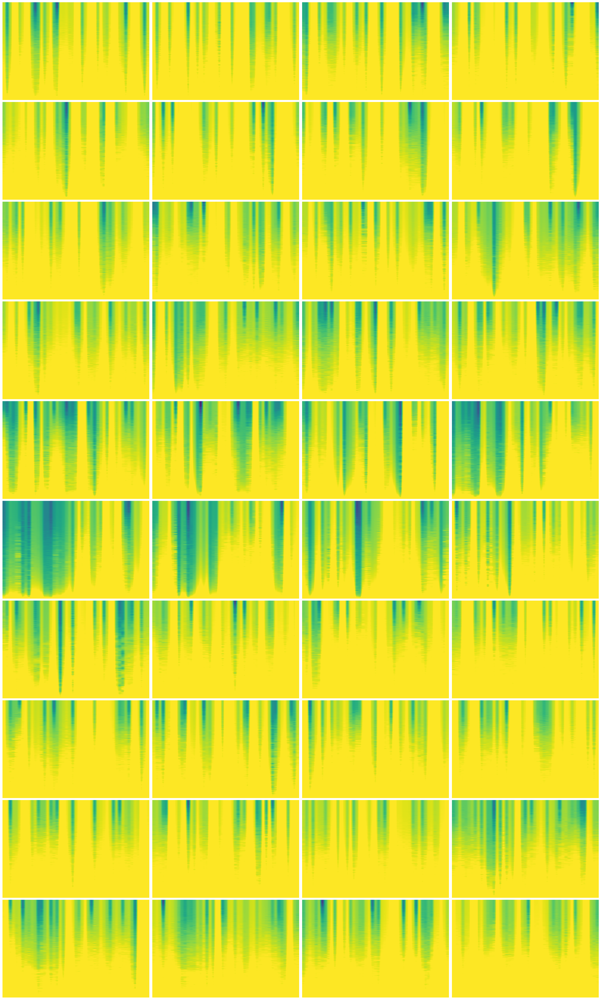

Savedfile: 16_02_2022_13_49_15_00_hdf5
Uncollectable garbage: []
Data loaded from file: E:/be22004_018\16.02.2022_13.49.25_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)
E:/thesis2024/ImageData/oilandgas/be22004_018\16_02_2022_13_49_25_00_hdf5.png


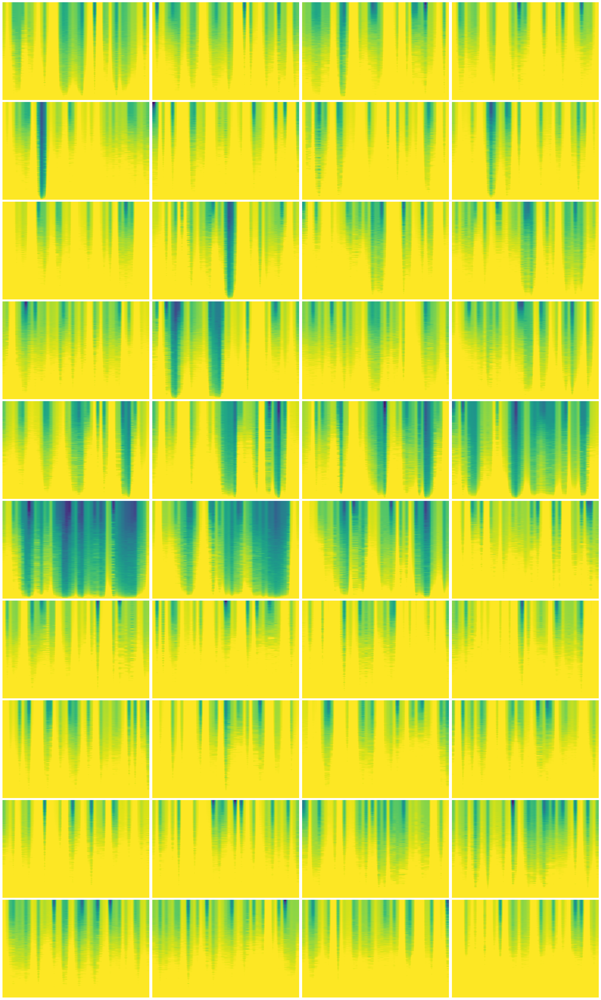

Savedfile: 16_02_2022_13_49_25_00_hdf5
Uncollectable garbage: []
Data loaded from file: E:/be22004_018\16.02.2022_13.49.35_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)
E:/thesis2024/ImageData/oilandgas/be22004_018\16_02_2022_13_49_35_00_hdf5.png


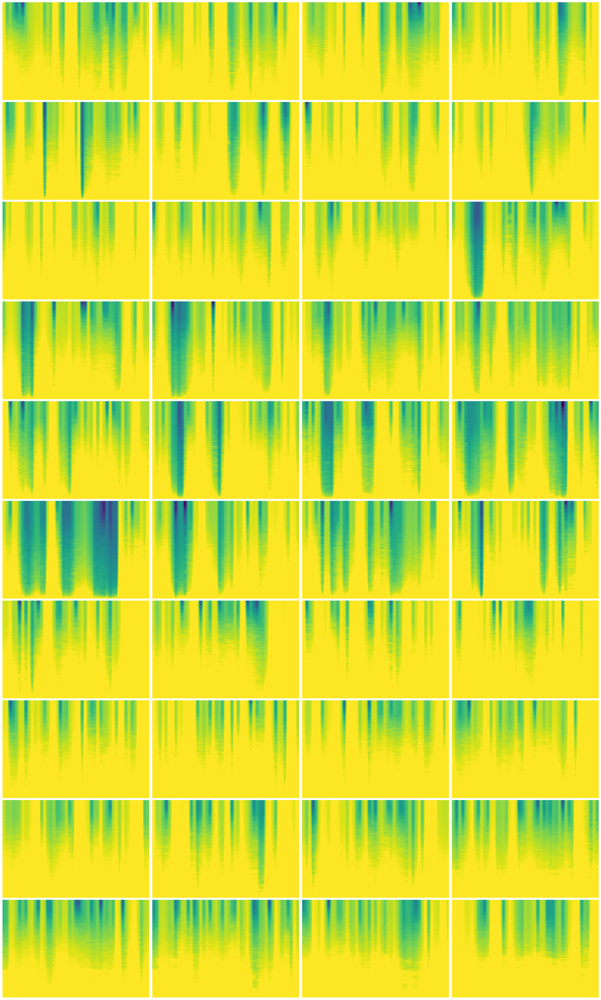

Savedfile: 16_02_2022_13_49_35_00_hdf5
Uncollectable garbage: []
Data loaded from file: E:/be22004_018\16.02.2022_13.49.45_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)
E:/thesis2024/ImageData/oilandgas/be22004_018\16_02_2022_13_49_45_00_hdf5.png


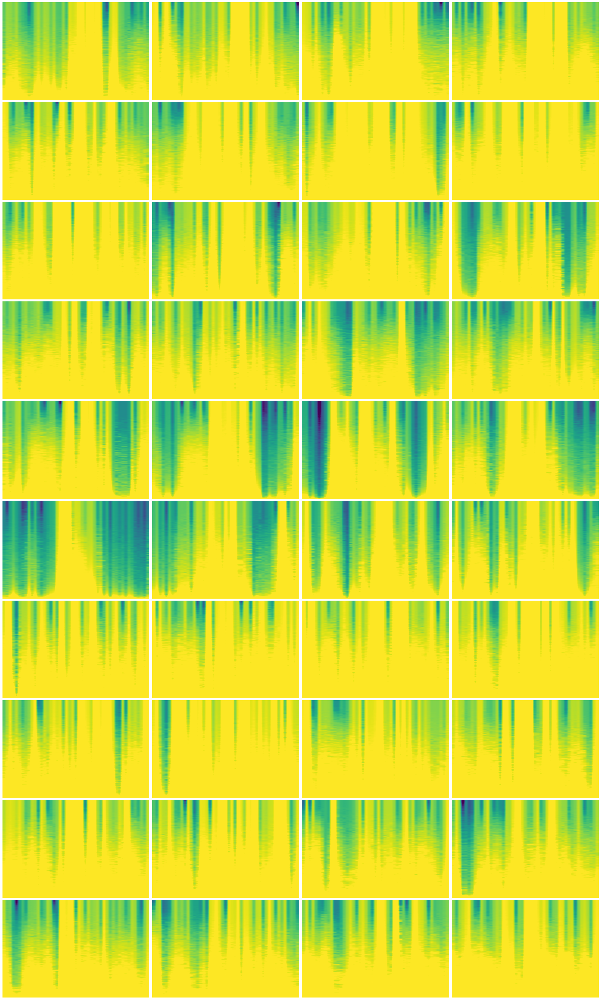

Savedfile: 16_02_2022_13_49_45_00_hdf5
Uncollectable garbage: []
Data loaded from file: E:/be22004_018\16.02.2022_13.49.55_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)
E:/thesis2024/ImageData/oilandgas/be22004_018\16_02_2022_13_49_55_00_hdf5.png


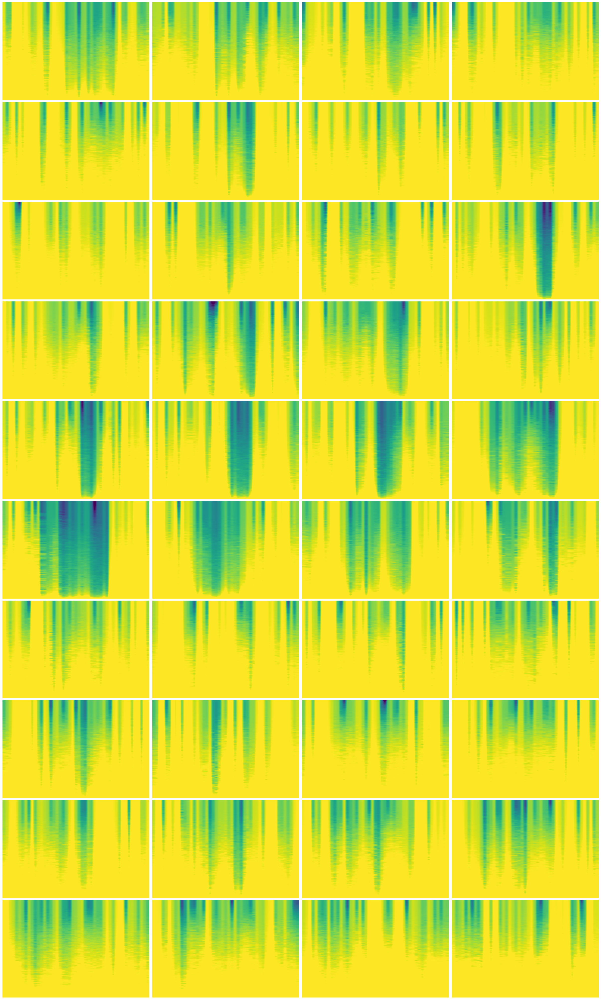

Savedfile: 16_02_2022_13_49_55_00_hdf5
Uncollectable garbage: []


In [199]:
data_dict = {}  # Initialize data dictionary to store data for each file

# for file_path in hdf5_files:
for file_path in hdf5_files[0:8]:
    #print(f"Processing file: {file_path}")
    with h5py.File(file_path, 'r') as file:
        
        group = file['Phase data group']
        data = file['Phase data group/Data'][...]  # This loads the data into memory 
        
        print(f"Data loaded from file: {file_path}")  

        # Scale factors for x and y axes
        print(data.shape)
        x_scale = (1/pulsefreq) # Replace with your x scale factor
        y_scale = samplespacing  # Replace with your y scale factor

        # Check if bandpass filter should be applied
        if apply_bandpass_filter:
            # Apply bandpass filter
            fs = 1.0 / delta_t  # Sampling frequency
            filtered_data = butter_bandpass_filter(data, f_low, f_high, fs)
        else:
            # If filter is not applied, use the original data
            filtered_data = data

        data_dict[str(parse_date_from_filename(file_path))] = [filtered_data] 
        
        # Renormalize the color scale
        vmin, vmax = np.min(filtered_data), np.max(filtered_data)      
        
        # Downsample the data
        downsampledfiltered_data = downsample_data(filtered_data, downsample_factor)
        print("Downsampled filtered data shape:", downsampledfiltered_data.shape)

        # Adjust the x-coordinates
        y_coords, x_coords = np.mgrid[0:data.shape[0], 0:data.shape[1]:downsample_factor]
        x_scaledcoords = x_coords * x_scale
        y_scaledcoords = y_coords * y_scale + first_distance

        # Define the y-axis limits
        y_lower_limit = 145  # Lower limit in meters
        y_upper_limit = 161  # Upper limit in meters

        # Find the indices corresponding to the specified y-axis limits
        y_lower_index = int((y_lower_limit - first_distance) / samplespacing)
        y_upper_index = int((y_upper_limit - first_distance) / samplespacing)

        # Slice the data to focus on the specified y-axis limits
        sliced_data = downsampledfiltered_data[y_lower_index:y_upper_index, :]
        print("Sliced data shape:", sliced_data.shape)

        # Apply the moving average filter with a large window size
        ##smoothed_data = moving_average_2d(sliced_data, window_size=2048)

        # Do the short-time Fourier transform
        mag_S_dat, (p1, p2), t_windowCenters = getSTFT4DataAtLoci(sliced_data, loci, SFT)
        

        mag_S_dat.shape  # (loci index, frequency index, time window index)

        
        #Plotting the data using imshow
        #plt.figure(figsize=(19, 12))
        #plt.imshow(sliced_data, cmap='viridis', vmin=vmin, vmax=vmax, aspect='auto', extent=[x_scaledcoords[0, 0], x_scaledcoords[-1, -1], y_lower_limit, y_upper_limit])
        #plt.colorbar()  
        #plt.xlabel('time/s')  
        #plt.ylabel('distance/m')
        

       
        fig, axes = plt.subplots(10, 4, figsize=(24, 40), constrained_layout=True)

        for i in range(10):
            for j in range(4):
                idx_loc = i * 4 + j
                if idx_loc < 40:
                    ax = axes[i, j]
                    im = ax.imshow(np.log10(mag_S_dat[idx_loc]), cmap='viridis', origin='lower',
                                   vmin=-7, vmax=-4,
                                   aspect='auto',
                                   extent=[t_windowCenters[0], t_windowCenters[-1], SFT.f[0], SFT.f[-1]])
                    #ax.set_xlabel('time (sec)')
                    #ax.set_ylabel('freq (Hz)')
                    #ax.set_title(f'loci={loci[idx_loc]}')
                    # Hide x and y ticks
                    ax.set_xticks([])
                    ax.set_yticks([])
        
                    # Optionally, you can also turn off the axis lines if desired
                    ax.axis('off')
        # Adjusting the spacing between subplots
        plt.subplots_adjust(wspace=0.1, hspace=0.1)
        # Manually adjust layout and add colorbar outside the main figure area
        #plt.subplots_adjust(right=0.85)  # Adjust right boundary to make room for the colorbar
        #cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])  # Position the colorbar outside the main figure area
        #plt.colorbar(im, cax=cbar_ax)
        
        # Save the plot as an image
        filename = os.path.splitext(os.path.basename(file_path).replace('.','_'))[0]
        image_path = os.path.join(image_dir, filename + '.png')
        plt.draw()  # Ensure the figure is drawn
        print(image_path)
        time.sleep(1)  # Add a short delay before saving
        plt.savefig(image_path, dpi=300, bbox_inches='tight')  # Save with high resolution and tight bounding box
        plt.show()
        print(f"Savedfile: {filename}")

        

       
        del data  # Free memory from the original data
        del downsampledfiltered_data
        # del x
        # del y
        del x_scaledcoords
        del y_scaledcoords
        gc.collect()  # Explicit garbage collection
        print("Uncollectable garbage:", gc.garbage)
        plt.clf() 
        plt.close()  # Close the figure to free memory

       

Data loaded from file: E:/be22004_018\16.02.2022_13.48.55_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)
E:\thesis2024\fft_testing\16_02_2022_13_48_55_00_hdf5.png


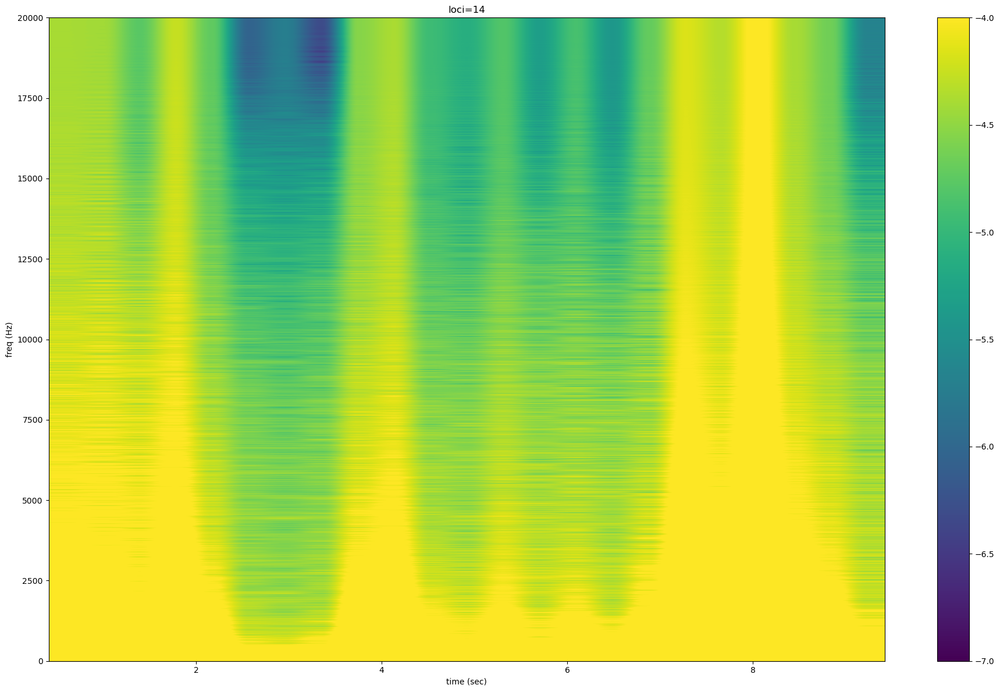

Savedfile: 16_02_2022_13_48_55_00_hdf5
Data loaded from file: E:/be22004_018\16.02.2022_13.49.05_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)
E:\thesis2024\fft_testing\16_02_2022_13_49_05_00_hdf5.png


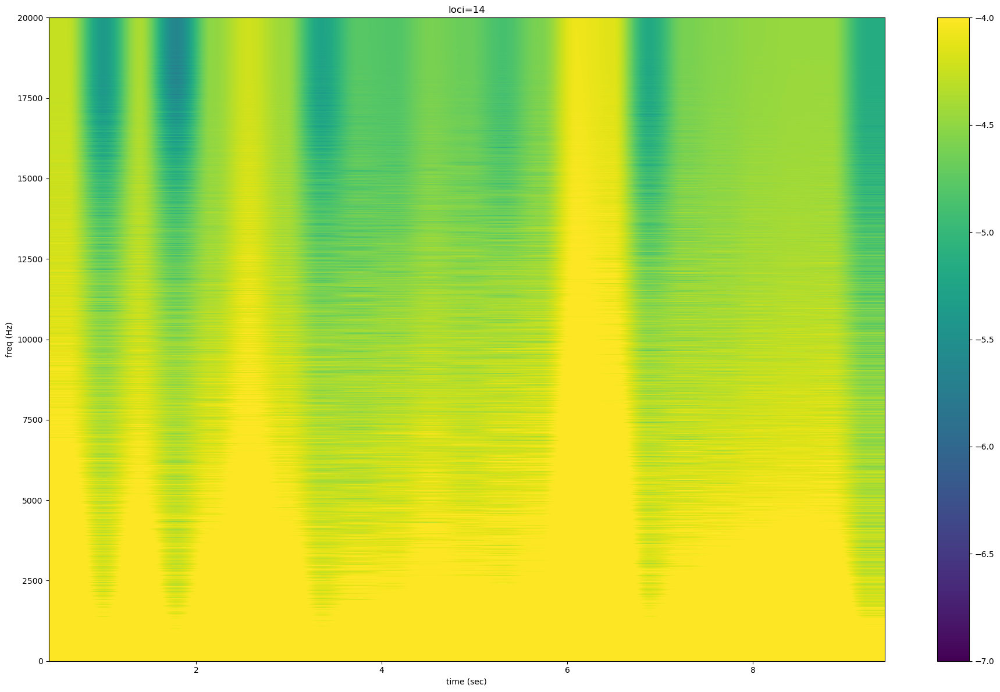

Savedfile: 16_02_2022_13_49_05_00_hdf5
Data loaded from file: E:/be22004_018\16.02.2022_13.49.15_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)
E:\thesis2024\fft_testing\16_02_2022_13_49_15_00_hdf5.png


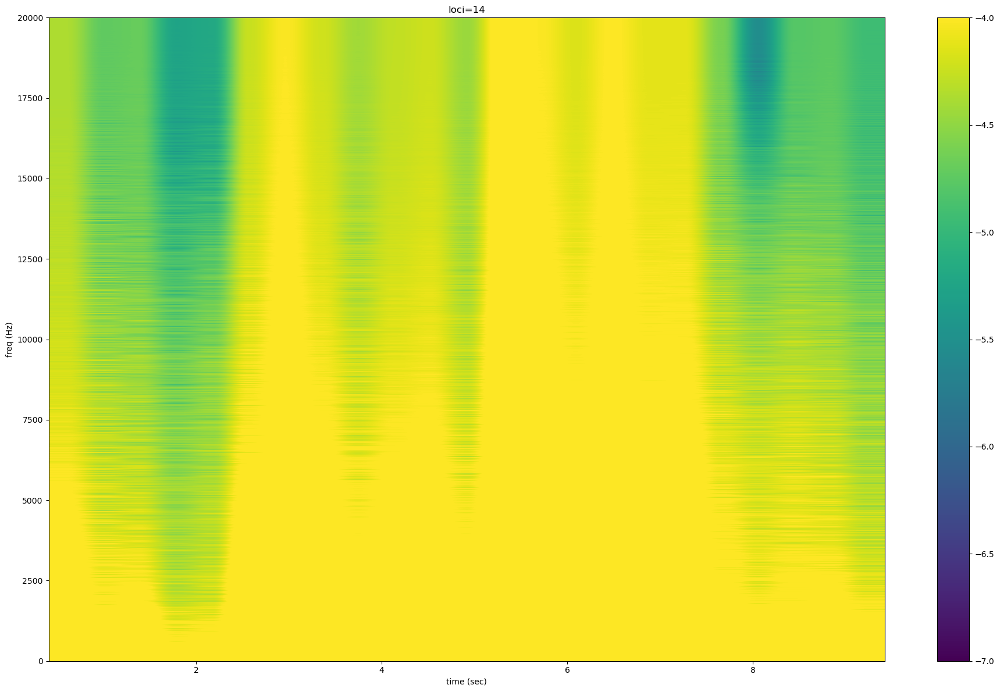

Savedfile: 16_02_2022_13_49_15_00_hdf5
Data loaded from file: E:/be22004_018\16.02.2022_13.49.25_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)
E:\thesis2024\fft_testing\16_02_2022_13_49_25_00_hdf5.png


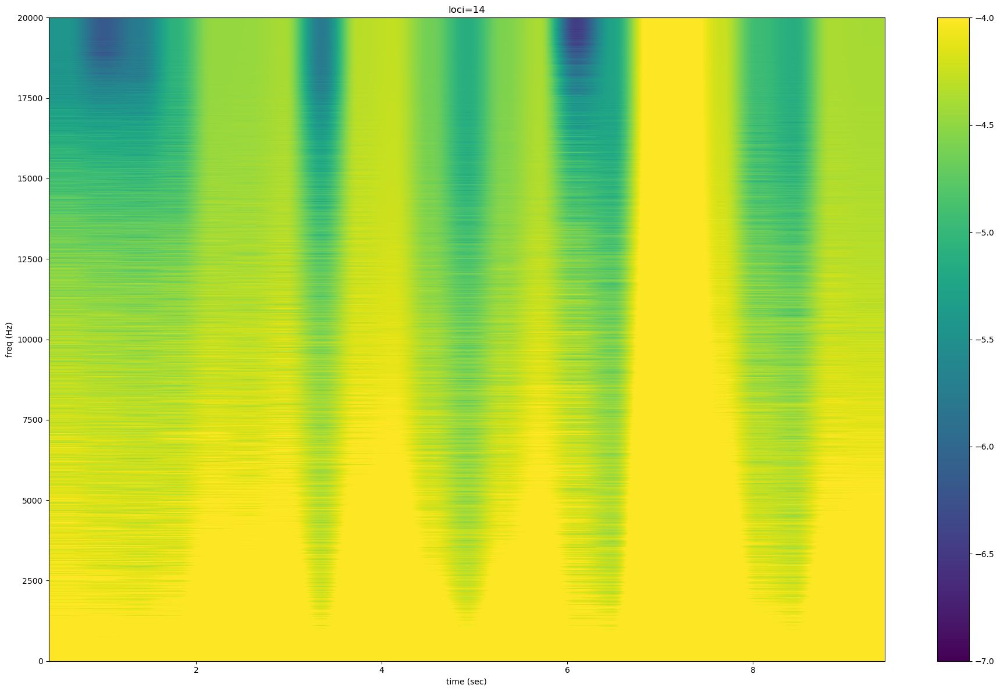

Savedfile: 16_02_2022_13_49_25_00_hdf5
Data loaded from file: E:/be22004_018\16.02.2022_13.49.35_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)
E:\thesis2024\fft_testing\16_02_2022_13_49_35_00_hdf5.png


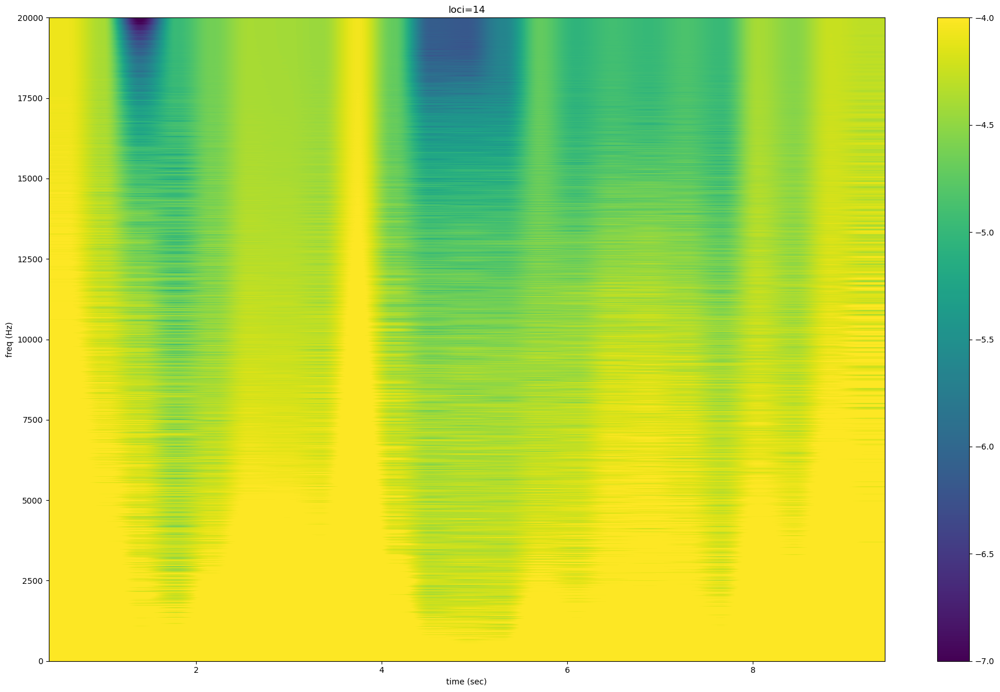

Savedfile: 16_02_2022_13_49_35_00_hdf5
Data loaded from file: E:/be22004_018\16.02.2022_13.49.45_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)
E:\thesis2024\fft_testing\16_02_2022_13_49_45_00_hdf5.png


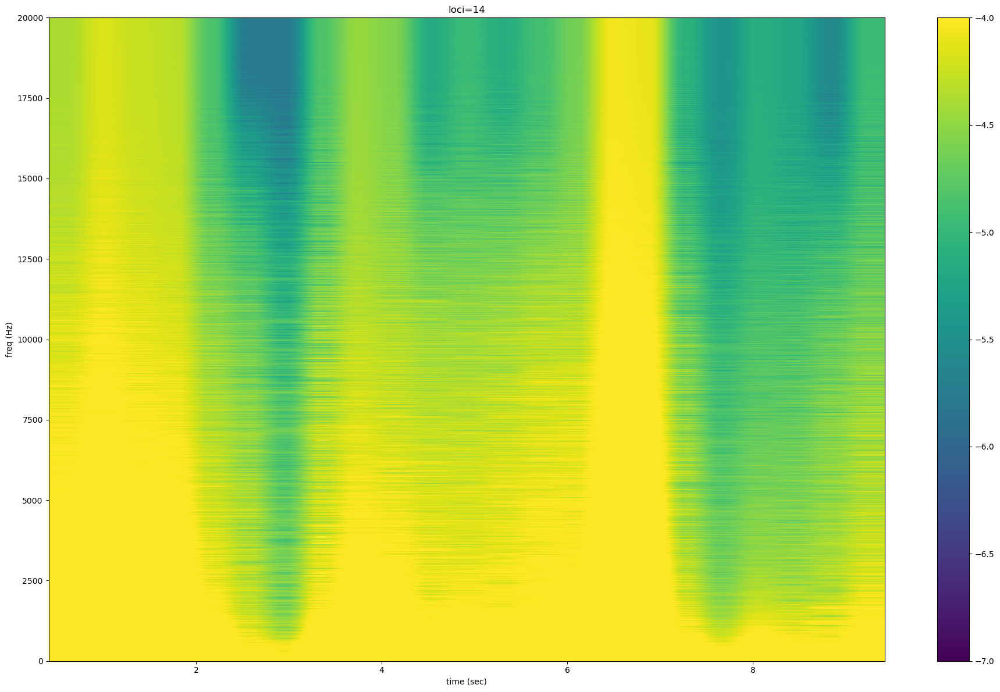

Savedfile: 16_02_2022_13_49_45_00_hdf5
Data loaded from file: E:/be22004_018\16.02.2022_13.49.55_00.hdf5
(678, 401407)
Downsampled filtered data shape: (678, 401407)
Sliced data shape: (40, 401407)
E:\thesis2024\fft_testing\16_02_2022_13_49_55_00_hdf5.png


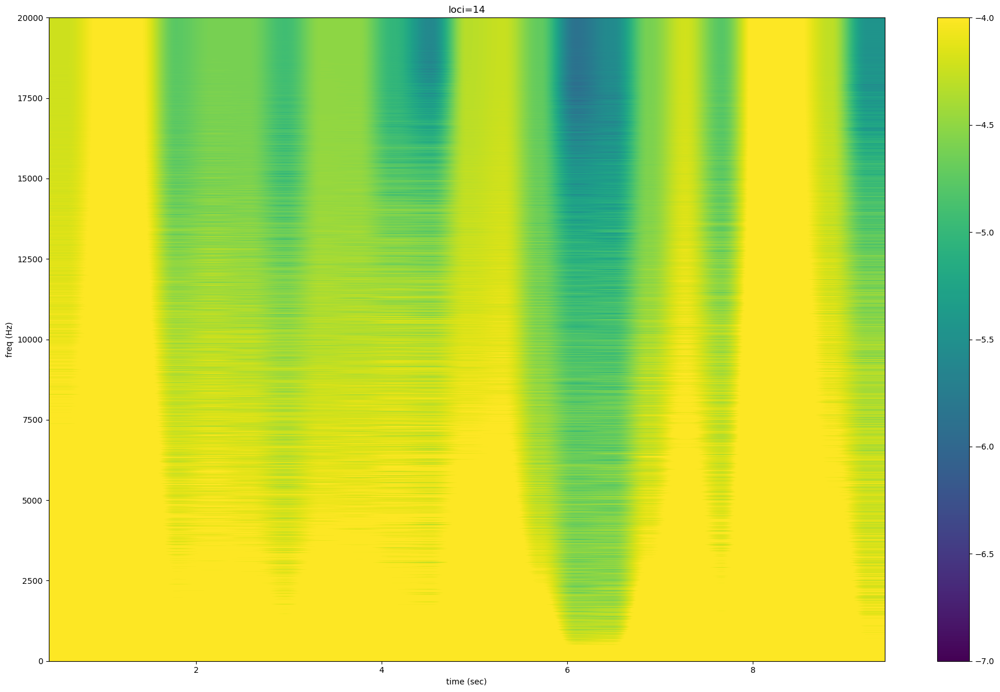

Savedfile: 16_02_2022_13_49_55_00_hdf5


In [239]:
np.std(sliced_data[loci,:],axis=1)
#print(loci)

array([ 6.5169725 ,  5.8347087 ,  0.6046183 ,  1.2913609 ,  1.4098905 ,
       10.014722  ,  5.0782766 ,  9.430378  ,  3.0532758 ,  1.369761  ,
        5.2726455 ,  5.291465  ,  6.2817945 ,  3.6102917 , 11.264823  ,
        7.6400633 , 21.030266  ,  2.0438144 ,  1.7557248 ,  0.87698007,
        0.172698  ,  0.8146409 ,  1.5249493 , 14.800553  ,  2.5499566 ,
        4.629449  , 19.469671  , 59.582798  ,  2.3939753 , 10.271576  ,
        5.5754423 ,  4.2924685 ,  7.1200185 , 39.398464  , 16.052286  ,
       16.35802   ,  9.247415  , 27.231312  ,  5.4131794 , 56.17973   ],
      dtype=float32)

Text(0.5, 0, 'frequency (Hz)')

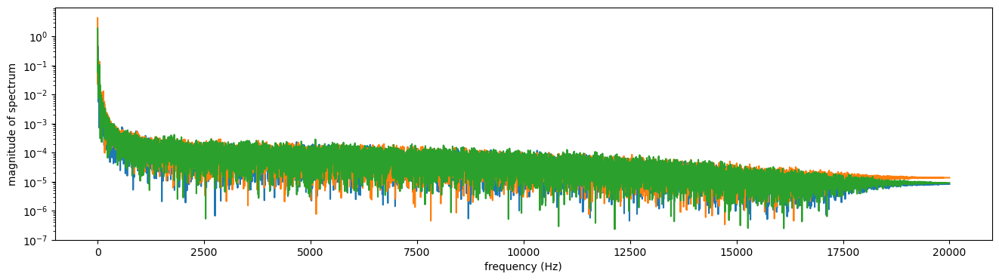

In [20]:
loc = 10  # pick one location

fig, axes = plt.subplots(1,1,figsize=(16,4))

plt.plot(SFT.f, abs(mag_S_dat[loc,:,0]))  # 0-th time window
plt.plot(SFT.f, abs(mag_S_dat[loc,:,8]))  # 4-th time window 
plt.plot(SFT.f, abs(mag_S_dat[loc,:,15]))  # 8-th time window 
plt.yscale('log')
plt.ylabel('magnitude of spectrum')
plt.xlabel('frequency (Hz)')

In [21]:
import matplotlib.patches as patches

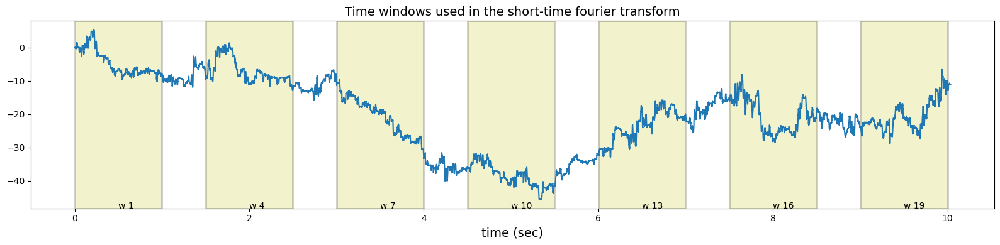

In [22]:
fig = plt.figure(figsize=(16,4))

datAtOneLoc = sliced_data[39,:]

t = np.arange(len(datAtOneLoc)) * delta_t

plt.plot(t, datAtOneLoc)
plt.title('Time windows used in the short-time fourier transform', fontsize=14)
plt.xlabel('time (sec)', fontsize=14)
plt.tight_layout()

# Plot the windows
(y_low, y_high) = plt.gca().get_ylim()  # Get the limit of the plot on y-axis
rect_height = y_high - y_low   # height of the window to draw
rect_width = SFT.win.size * delta_t   # width of the window

colors = ['r','y','g']
for p in range(p1, p2, 3):
    center_x = SFT.delta_t * p  # centers on time axis       
    rect_lowerLeftCorner_x = center_x - rect_width / 2  # x-coordinate of the left side of the window  
    rect_lowerLeftCorner_y = y_low  # y-coordinate of the bottom of the window      
    rect = patches.Rectangle((rect_lowerLeftCorner_x, rect_lowerLeftCorner_y), rect_width, rect_height, 
                             facecolor=colors[p % len(colors)], edgecolor='k', linewidth=2, alpha=0.2)
    plt.text(center_x, rect_lowerLeftCorner_y, f'w {p}')
    plt.gca().add_patch(rect)



In [ ]:
on_pipe_intervals_dict = {'D':[145,183], 'C':[200,238], 'B':[268,306], 'A':[322,360]}  # fiber intervals top/bottom in m: without coating top = D, with coating top = C, 
                                                                                       # without coating bottom = B, with coating bottom = A

# If you have time you can perhaps look at the sensitivity to top/bottom, coating/no coating sensitivity 
# If you do not have time then I would probably recommend looking at the bottom section without coating ie interval B 
# as you should only consider the interval downstream of the inflow ('perforation') points (for experiments with no injection from IP2 i.e with no annular flow downstream of the injection point)
# you will only use the last 16m of these intervals i.e. 


on_pipe_intervals_dict_no_ann_flow = = {'D':[167,183], 'C':[222,238], 'B':[290,306], 'A':[344,360]}


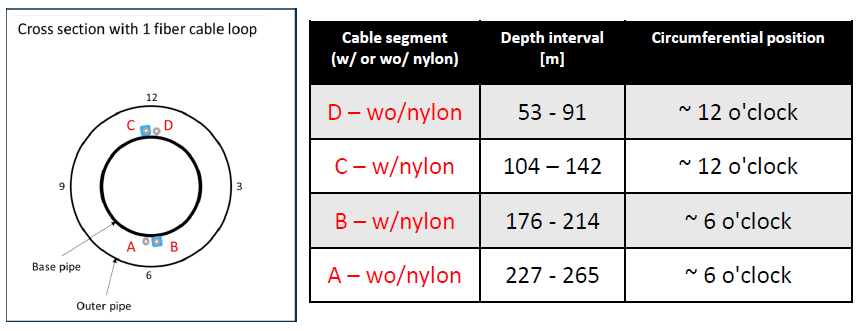

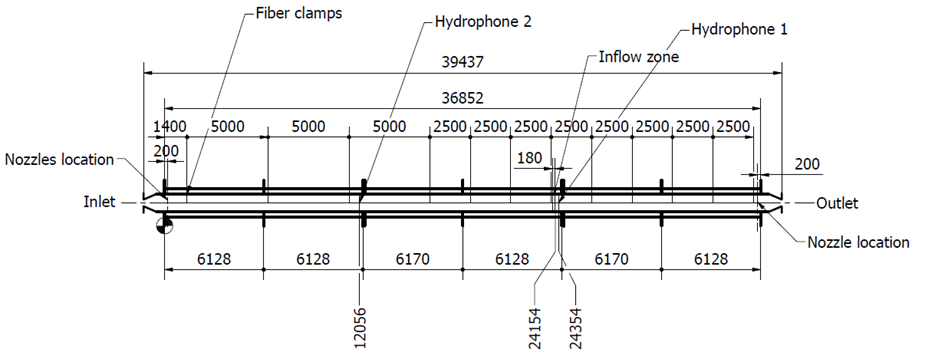

In [ ]:
exp_num = hdf5_dir.split('\\')[-2]    